In [230]:
import logging
gpd_logger = logging.getLogger('geopandas')
gpd_logger.setLevel(logging.WARNING)
mpl_logger = logging.getLogger('matplotlib')
mpl_logger.setLevel(logging.WARNING)
fi_logger = logging.getLogger('fiona')
fi_logger.setLevel(logging.WARNING)
import pandas as pd
import geopandas as gpd
import shapefile
import plotly.offline as po
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
import xarray as xr
import xsimlab as xs
from episimlab.partition import partition
from episimlab.setup.coords import InitDefaultCoords
import multiprocessing as mp
from datetime import datetime

In [284]:
sim_data = xr.open_zarr('/Users/kpierce/episimlab/results/DemoATX_78746_start.zarr/')

In [285]:
sim_data

<xarray.Dataset>
Dimensions:                          (age_group: 5, compartment: 16, risk_group: 2, step: 195, vertex: 87)
Coordinates:
  * age_group                        (age_group) object '18-49' '5-17' ... '<5'
  * compartment                      (compartment) object 'S' 'E' ... 'H2D'
  * risk_group                       (risk_group) object 'low' 'high'
  * step                             (step) datetime64[ns] 2020-03-11 ... 202...
  * vertex                           (vertex) float64 7.651e+04 ... 7.896e+04
Data variables:
    apply_counts_delta__counts       (step, vertex, age_group, risk_group, compartment) float64 dask.array<chunksize=(98, 44, 3, 1, 8), meta=np.ndarray>
    foi__beta                        float64 ...
    get_contact_xr__contacts_fp      <U50 ...
    get_contact_xr__travel_fp        <U61 ...
    read_config__config_fp           <U45 ...
    setup_counts__census_counts_csv  <U61 ...
    setup_counts__initial_ia         int64 ...
    setup_counts__initial_vertex     int64 ...

In [286]:
atx_zcta = gpd.read_file('/Users/kpierce/COVID19/austin-spatial-prev/central_tx_zcta_2019.shp')

In [287]:
sim_arr = sim_data['apply_counts_delta__counts']


In [288]:
def spatial_simulation(xr_array, shape, compartment):
    
    xr_compt = xr_array.sel({'compartment': compartment}).sum(dim=['risk_group', 'age_group'])
    df_compt = xr_compt.to_dataframe().reset_index()
    df_compt['vertex'] = [str(int(i)) for i in df_compt['vertex']]
    df_compt['date'] = [
        datetime.strftime(pd.to_datetime(i), '%Y-%m-%d') for i in df_compt['step']
    ]
    df_shape = gpd.GeoDataFrame(
        pd.merge(df_compt, shape, left_on='vertex', right_on='GEOID10', how='left'),
        crs=shape.crs
    )
    df_shape['lon'] = [i.centroid.coords[0][0] if i else None for i in df_shape['geometry']]
    df_shape['lat'] = [i.centroid.coords[0][1] if i else None for i in df_shape['geometry']]
    
    return df_shape

In [373]:
sympt_inf = spatial_simulation(sim_arr, atx_zcta, 'Iy')
asymp_inf = spatial_simulation(sim_arr, atx_zcta, 'Ia')
sympt_inf = pd.merge(sympt_inf, asymp_inf, on=['step', 'vertex', 'lon', 'lat', 'date'])


In [343]:
#sympt_inf['apply_counts_delta__counts'] = sympt_inf['apply_counts_delta__counts_x'] + sympt_inf['apply_counts_delta__counts_y']

In [344]:
sympt_inf.head()

,step,vertex,compartment,apply_counts_delta__counts,date,ZCTA5CE10,GEOID10,CLASSFP10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,geometry,lon,lat
0,2020-03-11,76511,Ih,0.0,2020-03-11,76511,76511,B5,G6350,S,203065394,1122766,+30.8020858,-097.4243625,"POLYGON ((-97.56603 30.77231, -97.56502 30.772...",-97.424958,30.801637
1,2020-03-11,76527,Ih,0.0,2020-03-11,76527,76527,B5,G6350,S,332470554,1088225,+30.8417951,-097.8096985,"POLYGON ((-97.93982 30.80608, -97.93973 30.806...",-97.806044,30.844162
2,2020-03-11,76530,Ih,0.0,2020-03-11,76530,76530,B5,G6350,S,241943599,13272951,+30.7108572,-097.4138850,"POLYGON ((-97.57607 30.74045, -97.57495 30.740...",-97.421746,30.715831
3,2020-03-11,76537,Ih,0.0,2020-03-11,76537,76537,B5,G6350,S,139263240,523639,+30.8174007,-097.6028998,"POLYGON ((-97.68896 30.81950, -97.68550 30.820...",-97.605447,30.817491
4,2020-03-11,76574,Ih,0.0,2020-03-11,76574,76574,B5,G6350,S,368793648,8384387,+30.5793270,-097.3886221,"POLYGON ((-97.50380 30.59862, -97.50058 30.599...",-97.387405,30.584231


In [325]:
fig = px.scatter_mapbox(
    sympt_inf,
    lat='lat',
    lon='lon',
    color="apply_counts_delta__counts",
    range_color=[1, max(sympt_inf['apply_counts_delta__counts'])],
    hover_name="vertex", 
    size="apply_counts_delta__counts",
    animation_frame="date",
)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

In [292]:
np.mean(sympt_inf['lat'])

30.308172626148533

In [293]:
np.mean(sympt_inf['lon'])

-97.71125862886531

In [294]:
token = open(".mapbox_token").read()

In [326]:
dates = sympt_inf['date'].unique()

In [327]:
sympt_inf[sympt_inf['date']==dates[0]]['lat']

0     30.801637
1     30.844162
2     30.715831
3     30.817491
4     30.584231
        ...    
82    30.351538
83    30.387988
84    30.402667
85    29.852200
86    30.012859
Name: lat, Length: 87, dtype: float64

In [345]:
sympt_inf['marker_size'] = (sympt_inf['apply_counts_delta__counts']/max(sympt_inf['apply_counts_delta__counts']))*100

In [346]:
sympt_inf['count'] = [str(round(i, 2)) for i in sympt_inf['apply_counts_delta__counts']]

In [331]:
#https://chart-studio.plotly.com/~empet/14825/scattermapbox-animation-forum-question/#/
hovertemplate='%{customdata[0]}<br>%{customdata[1]} cases'
d1 = sympt_inf[sympt_inf['date'] == min(sympt_inf['date'])]
fig = go.Figure(
    go.Scattermapbox(
        lat=[d1['lat']],
        lon=[d1['lon']],
        mode='markers',
        marker=dict(
            size=d1['marker_size'], 
            color='red'
        ),
        customdata=d1[['vertex', 'count']].to_numpy(),
        hovertemplate=hovertemplate
    )
)
        
# update with successive dates
fig.update_layout(
    mapbox=dict(
        accesstoken=token,
        bearing=0,
        center=dict(lat=30.3,
        lon=-97.7),
        pitch=0,
        zoom=8.5,
        style='carto-positron'
    )
)

frames = [
    go.Frame(
        data=[
            go.Scattermapbox(
                lat=sympt_inf[sympt_inf['date']==dates[k]]['lat'], 
                lon=sympt_inf[sympt_inf['date']==dates[k]]['lon'],
                marker=dict(
                    size=sympt_inf[sympt_inf['date']==dates[k]]['marker_size'], 
                    color='red'
                ),
                customdata=sympt_inf[sympt_inf['date']==dates[k]][['vertex', 'count']].to_numpy(),
                hovertemplate=hovertemplate
            )],
        traces=[0],
        name=f'frame{k}') for k in range(len(dates))
]    

fig.update(frames=frames);

sliders = [
    dict(
        steps=[
            dict(
                method='animate',
                args=[
                    [f'frame{k}'],
                    dict(mode='immediate',frame=dict(duration=len(dates), redraw= True), transition=dict(duration=0))
                ],
                label=dates[k]
            ) for k in range(len(dates))
        ],
        transition= dict(duration= 0 ),
        x=0,#slider starting position  
        y=0, 
        currentvalue=dict(
            font=dict(size=12),
            prefix='Date: ', 
            visible=True, 
            xanchor='center'),
        len=1.0)
]

fig.update_layout(
    #updatemenus=[
    #    dict(
    #        type='buttons', 
    #        showactive=False,
    #        y=0,
    #        x=1.05,
    #        xanchor='right',
    #        yanchor='top',
    #        pad=dict(t=0, r=10),
    #        buttons=[
    #            dict(label='Play',method='animate',
    #                 args=[None, 
    #                      dict(frame=dict(duration=len(dates), redraw=True),
    #                           transition=dict(duration=0),
    #                           fromcurrent=True,
    #                           mode='immediate')
    #                     ]
    #            )
    #        ]
    #    )
    #],
    sliders=sliders)
fig.show()

In [300]:
hovertemplate='%{customdata[0]}<br>%{customdata[1]} cases<extra></extra>'
d1 = sympt_inf[sympt_inf['date'] == min(sympt_inf['date'])]
aggregate = sympt_inf.groupby(['date']).sum('apply_counts_delta__counts').reset_index()

#https://chart-studio.plotly.com/~empet/15243/animating-traces-in-subplotsbr/#/
fig = make_subplots(
    rows=1, cols=2, 
    specs=[[{"type": "mapbox"}, {"type": "scatter"}]],
    subplot_titles=('Symptomatic cases by patient residence zip code', 'Total number of symptomatic cases')
)
fig.add_trace(
    go.Scattermapbox(
        lat=[d1['lat']],
        lon=[d1['lon']],
        mode='markers',
        marker=dict(
            size=d1['marker_size'], 
            color='red'
        ),
        customdata=d1[['vertex', 'count']].to_numpy(),
        hovertemplate=hovertemplate
    ),
        row=1,
        col=1
)

# for some reason I don't fully understand, we need to do this twice...
fig.add_trace(
    go.Scatter(
        x=aggregate['date'],
        y=aggregate['apply_counts_delta__counts'],
        mode='lines',
        line=dict(width=2, color='gray', dash='dot')
    ), row=1, col=2
)

fig.add_trace(
    go.Scatter(
        x=aggregate['date'],
        y=aggregate['apply_counts_delta__counts'],
        mode='lines',
        line=dict(width=2, color='gray', dash='dot')
    ), row=1, col=2
)

# update with successive dates
fig.update_layout(
    mapbox=dict(
        accesstoken=token,
        bearing=0,
        center=dict(lat=30.3,
        lon=-97.7),
        pitch=0,
        zoom=8.5,
        style='carto-positron'
    )
)

frames = [
    go.Frame(
        data=[
            go.Scattermapbox(
                lat=sympt_inf[sympt_inf['date']==dates[k]]['lat'], 
                lon=sympt_inf[sympt_inf['date']==dates[k]]['lon'],
                marker=dict(
                    size=sympt_inf[sympt_inf['date']==dates[k]]['marker_size'], 
                    color='red'
                ),
                customdata=sympt_inf[sympt_inf['date']==dates[k]][['vertex', 'count']].to_numpy(),
                hovertemplate=hovertemplate
            ),
            go.Scatter(
                x=aggregate['date'],
                y=aggregate['apply_counts_delta__counts'],
                mode='lines',
                line=dict(width=2, color='gray')
            ),
            go.Scatter(
                x=[dates[k]],
                y=[sum(sympt_inf[sympt_inf['date']==dates[k]]['apply_counts_delta__counts'])],
                mode='markers',
                marker=dict(size=10, color='red')
            )
        ],
        traces=[0, 1, 2], # there are 2 subplots but three traces, we need to request the three traces here
        name=f'frame{k}') for k in range(len(dates))
]    

fig.update(frames=frames);

sliders = [
    dict(
        steps=[
            dict(
                method='animate',
                args=[
                    [f'frame{k}'],
                    dict(mode='immediate',frame=dict(duration=len(dates), redraw= True), transition=dict(duration=0))
                ],
                label=dates[k]
            ) for k in range(len(dates))
        ],
        transition= dict(duration=0),
        x=0.05,#slider starting position  
        y=-0.01, 
        currentvalue=dict(
            font=dict(size=18),
            prefix='Date: ', 
            visible=True, 
            xanchor='left'),
        len=1.0)
]

fig.update_xaxes(row=1, col=2, range=[min(dates), max(dates)])
fig.update_yaxes(row=1, col=2, range=[0, 142000])
fig.update_layout(
    updatemenus=[
        dict(
            type='buttons', 
            showactive=False,
            y=-0.05,
            x=0.01,
            xanchor='right',
            yanchor='top',
            pad=dict(t=0, r=10),
            buttons=[
                dict(label='Play',method='animate',
                     args=[None, 
                          dict(frame=dict(duration=500, redraw=True),
                               transition=dict(duration=100),
                               fromcurrent=True,
                               mode='immediate')
                         ]
                ),
                dict(label='Pause', method='animate',
                     args=[
                         [None], # None must be in brackets or the pause button does not work
                         dict(frame=dict(duration=0, redraw=False),
                             mode='immediate',
                             transition=dict(duration=0))
                            ]
                    )
            ]
        )
    ],
    template='plotly_white',
    font=dict(size=18),
    showlegend=False,
    sliders=sliders)
fig.update_annotations(font_size=20)
#po.plot(fig,filename='/Users/kpierce/episimlab/demo_map_timeseries.html',auto_open=False)
fig.show()

In [301]:
sympt_inf.head()

,step,vertex,compartment,apply_counts_delta__counts,date,ZCTA5CE10,GEOID10,CLASSFP10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,geometry,lon,lat,marker_size,count
0,2020-03-11,76511,Iy,0.0,2020-03-11,76511,76511,B5,G6350,S,203065394,1122766,+30.8020858,-097.4243625,"POLYGON ((-97.56603 30.77231, -97.56502 30.772...",-97.424958,30.801637,0.0,0.0
1,2020-03-11,76527,Iy,0.0,2020-03-11,76527,76527,B5,G6350,S,332470554,1088225,+30.8417951,-097.8096985,"POLYGON ((-97.93982 30.80608, -97.93973 30.806...",-97.806044,30.844162,0.0,0.0
2,2020-03-11,76530,Iy,0.0,2020-03-11,76530,76530,B5,G6350,S,241943599,13272951,+30.7108572,-097.4138850,"POLYGON ((-97.57607 30.74045, -97.57495 30.740...",-97.421746,30.715831,0.0,0.0
3,2020-03-11,76537,Iy,0.0,2020-03-11,76537,76537,B5,G6350,S,139263240,523639,+30.8174007,-097.6028998,"POLYGON ((-97.68896 30.81950, -97.68550 30.820...",-97.605447,30.817491,0.0,0.0
4,2020-03-11,76574,Iy,0.0,2020-03-11,76574,76574,B5,G6350,S,368793648,8384387,+30.5793270,-097.3886221,"POLYGON ((-97.50380 30.59862, -97.50058 30.599...",-97.387405,30.584231,0.0,0.0


In [302]:
census = pd.read_csv('/Users/kpierce/episimlab/data/data_lccf/census_pop1_rows1.csv', dtype={'GEOID': str})
census_zip = census.groupby('GEOID').sum('group_pop').reset_index()

In [303]:
census_zip

,GEOID,Unnamed: 0,group_pop
0,75001,15,14992
1,75002,40,71253
2,75006,65,51642
3,75007,90,55500
4,75009,115,14089
...,...,...,...
1930,79934,48265,26445
1931,79935,48290,17850
1932,79936,48315,111620
1933,79938,48340,84237


In [347]:
sympt_pct = pd.merge(sympt_inf, census_zip, left_on='vertex', right_on='GEOID', how='left')

In [348]:
sympt_pct.drop('marker_size', axis=1, inplace=True)

In [349]:
sympt_pct['burden_per_10k'] = (sympt_pct['apply_counts_delta__counts']/sympt_pct['group_pop'])*10000
sympt_pct['burden_per_10k_str'] = [str(round(i, 2)) for i in sympt_pct['burden_per_10k']]
sympt_pct['marker_size'] = (sympt_pct['burden_per_10k']/max(sympt_pct['burden_per_10k']))*100

aggregate_pct = sympt_pct.groupby(['date'])['apply_counts_delta__counts', 'group_pop'].sum().reset_index()
aggregate_pct['burden_per_10k'] = (aggregate_pct['apply_counts_delta__counts']/aggregate_pct['group_pop'])*10000
aggregate_pct['burden_per_10k_str'] = [str(round(i, 2)) for i in aggregate_pct['burden_per_10k']]

In [351]:
print(max(sympt_pct['marker_size']))
print(max(sympt_inf['marker_size']))

100.0
100.0


In [352]:
import matplotlib.pyplot as plt

(array([1.4342e+04, 1.8520e+03, 5.4200e+02, 6.5000e+01, 8.0000e+01,
        2.4000e+01, 3.4000e+01, 5.0000e+00, 1.6000e+01, 5.0000e+00]),
 array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.]),
 <BarContainer object of 10 artists>)

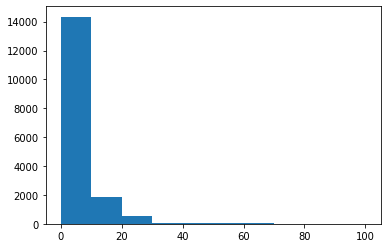

In [353]:
plt.hist(sympt_pct['marker_size'])

In [354]:
sympt_pct[(sympt_pct['vertex'].isin(['78742', '78744'])) & (sympt_pct['date']=='2020-06-02')]

,step,vertex,compartment,apply_counts_delta__counts,date,ZCTA5CE10,GEOID10,CLASSFP10,MTFCC10,FUNCSTAT10,...,geometry,lon,lat,count,GEOID,Unnamed: 0,group_pop,burden_per_10k,burden_per_10k_str,marker_size
7290,2020-06-02,78742,Ih,0.0,2020-06-02,78742,78742,B5,G6350,S,...,"POLYGON ((-97.69128 30.24518, -97.69111 30.245...",-97.658288,30.244148,0.0,78742,38540,887,0.000000,0.0,0.000000
7291,2020-06-02,78744,Ih,28.0,2020-06-02,78744,78744,B5,G6350,S,...,"POLYGON ((-97.78932 30.15937, -97.78920 30.159...",-97.729199,30.182776,28.0,78744,38565,50123,5.586258,5.59,11.206033


(array([1.4249e+04, 1.3570e+03, 6.1800e+02, 3.2100e+02, 1.9200e+02,
        1.5100e+02, 4.7000e+01, 1.8000e+01, 1.0000e+01, 2.0000e+00]),
 array([  0.,  10.,  20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100.]),
 <BarContainer object of 10 artists>)

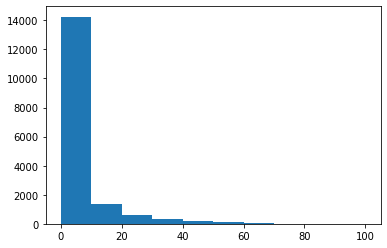

In [355]:
plt.hist(sympt_inf['marker_size'])

In [356]:
max(sympt_pct['burden_per_10k'])

49.85044865403788

In [357]:
max(aggregate_pct['burden_per_10k'])

9.010842066817116

In [389]:
hovertemplate_left='%{customdata[0]}<br>%{customdata[1]} per 10k<extra></extra>'
hovertemplate_right='%{customdata[0]}<br>%{customdata[1]} per 10k<extra></extra>'
d1 = sympt_pct[sympt_pct['date'] == min(sympt_pct['date'])] 

#https://chart-studio.plotly.com/~empet/15243/animating-traces-in-subplotsbr/#/
fig = make_subplots(
    rows=1, cols=2, 
    specs=[[{"type": "mapbox"}, {"type": "scatter"}]],
    subplot_titles=('Infection burden (cases per 10,000)\nby patient residence zip code', 'Total infection burden (cases per 10,000)')
)
fig.add_trace(
    go.Scattermapbox(
        lat=[d1['lat']],
        lon=[d1['lon']],
        mode='markers',
        marker=dict(
            size=25,#d1['marker_size'], 
            color=sympt_pct[sympt_pct['date']==dates[k]]['burden_per_10k'],
            colorbar=dict(title='', x=0.45),
            colorscale="Viridis",
            cmax=max(sympt_pct['burden_per_10k']),
            cmin=min(sympt_pct['burden_per_10k'])
        ),
        customdata=d1[['vertex', 'burden_per_10k_str']].to_numpy(),
        hovertemplate=hovertemplate_left
    ),
        row=1,
        col=1
)

# for some reason I don't fully understand, we need to do this twice...
fig.add_trace(
    go.Scatter(
        x=aggregate_pct['date'],
        y=aggregate_pct['burden_per_10k'],
        mode='lines',
        line=dict(width=2, color='gray', dash='dot'),
        hoverinfo='none'
    ), row=1, col=2
)

fig.add_trace(
    go.Scatter(
        x=aggregate_pct['date'],
        y=aggregate_pct['burden_per_10k'],
        mode='lines',
        line=dict(width=2, color='gray', dash='dot'),
        hoverinfo='none'
    ), row=1, col=2
)

# update with successive dates
fig.update_layout(
    mapbox=dict(
        accesstoken=token,
        bearing=0,
        center=dict(lat=30.3,
        lon=-97.7),
        pitch=0,
        zoom=8.5,
        style='stamen-toner'
    )
)

frames = [
    go.Frame(
        data=[
            go.Scattermapbox(
                lat=sympt_pct[sympt_pct['date']==dates[k]]['lat'], 
                lon=sympt_pct[sympt_pct['date']==dates[k]]['lon'],
                marker=dict(
                    size=25,#sympt_pct[sympt_pct['date']==dates[k]]['marker_size'], 
                    color=sympt_pct[sympt_pct['date']==dates[k]]['burden_per_10k'],
                    colorbar=dict(title='', x=0.45),
                    colorscale="Viridis",
                    cmax=max(sympt_pct['burden_per_10k']),
                    cmin=min(sympt_pct['burden_per_10k'])
                ),
                customdata=sympt_pct[sympt_pct['date']==dates[k]][['vertex', 'burden_per_10k_str']].to_numpy(),
                hovertemplate=hovertemplate_left
            ),
            go.Scatter(
                x=aggregate_pct['date'],
                y=aggregate_pct['burden_per_10k'],
                mode='lines',
                line=dict(width=2, color='gray')
            ),
            go.Scatter(
                x=[dates[k]],
                y=[sum(aggregate_pct[aggregate_pct['date']==dates[k]]['burden_per_10k'])],
                mode='markers',
                marker=dict(size=10, color='red'),
                customdata=aggregate_pct[aggregate_pct['date']==dates[k]][['date', 'burden_per_10k_str']].to_numpy(),
                hovertemplate=hovertemplate_right
            )
        ],
        traces=[0, 1, 2], # there are 2 subplots but three traces, we need to request the three traces here
        name=f'frame{k}') for k in range(len(dates))
]    

fig.update(frames=frames);

sliders = [
    dict(
        steps=[
            dict(
                method='animate',
                args=[
                    [f'frame{k}'],
                    dict(mode='immediate',frame=dict(duration=len(dates), redraw= True), transition=dict(duration=0))
                ],
                label=dates[k]
            ) for k in range(len(dates))
        ],
        transition= dict(duration=0),
        x=0.05,#slider starting position  
        y=-0.01, 
        currentvalue=dict(
            font=dict(size=18),
            prefix='Date: ', 
            visible=True, 
            xanchor='left'),
        len=1.0)
]

fig.update_xaxes(row=1, col=2, range=[min(dates), max(dates)])
#fig.update_yaxes(row=1, col=2, range=[0, 142000])
fig.update_layout(
    updatemenus=[
        dict(
            type='buttons', 
            showactive=False,
            y=-0.05,
            x=0.01,
            xanchor='right',
            yanchor='top',
            pad=dict(t=0, r=10),
            buttons=[
                dict(label='Play',method='animate',
                     args=[None, 
                          dict(frame=dict(duration=500, redraw=True),
                               transition=dict(duration=100),
                               fromcurrent=True,
                               mode='immediate')
                         ]
                ),
                dict(label='Pause', method='animate',
                     args=[
                         [None], # None must be in brackets or the pause button does not work
                         dict(frame=dict(duration=0, redraw=False),
                             mode='immediate',
                             transition=dict(duration=0))
                            ]
                    )
            ]
        )
    ],
    template='plotly_white',
    font=dict(size=18),
    showlegend=False,
    sliders=sliders)
fig.update_annotations(font_size=20)
#po.plot(fig,filename='/Users/kpierce/episimlab/demo_map_burden_timeseries_all_inf.html',auto_open=False)
fig.show()

In [407]:
def make_burden_plot(dataframe, start_date, stop_date):
    
    # data manipulation
    dataslice = dataframe[(dataframe['date'] >= start_date) & (dataframe['date'] <= stop_date)]
    dates = dataslice['date'].unique()
    
    aggregate_pct = dataframe.groupby(['date'])['apply_counts_delta__counts', 'group_pop'].sum().reset_index()
    aggregate_pct['burden_per_10k'] = (aggregate_pct['apply_counts_delta__counts']/aggregate_pct['group_pop'])*10000
    aggregate_pct['burden_per_10k_str'] = [str(round(i, 2)) for i in aggregate_pct['burden_per_10k']]
    agg_slice = aggregate_pct[(aggregate_pct['date'] >= start_date) & (aggregate_pct['date'] <= stop_date)]

    # templates
    hovertemplate_left='%{customdata[0]}<br>%{customdata[1]} per 10k<extra></extra>'
    hovertemplate_right='%{customdata[0]}<br>%{customdata[1]} per 10k<extra></extra>'
    
    # starting time slice
    d1 = dataslice[dataslice['date'] == min(dates)] 

    #https://chart-studio.plotly.com/~empet/15243/animating-traces-in-subplotsbr/#/
    fig = make_subplots(
        rows=1, cols=2, 
        specs=[[{"type": "mapbox"}, {"type": "scatter"}]],
        subplot_titles=('Hospitalizations (per 10,000)\nby patient residence zip code', 'Total hospitalizations (per 10,000)')
    )
    fig.add_trace(
        go.Scattermapbox(
            lat=[d1['lat']],
            lon=[d1['lon']],
            mode='markers',
            marker=dict(
                size=25,#d1['marker_size'], 
                color=d1[d1['date']==dates[k]]['burden_per_10k'],
                colorbar=dict(title='', x=0.45),
                colorscale="Viridis",
                cmax=max(d1['burden_per_10k']),
                cmin=0
            ),
            customdata=d1[['vertex', 'burden_per_10k_str']].to_numpy(),
            hovertemplate=hovertemplate_left
        ),
            row=1,
            col=1
    )

    # for some reason I don't fully understand, we need to do this twice...
    fig.add_trace(
        go.Scatter(
            x=agg_slice['date'],
            y=agg_slice['burden_per_10k'],
            mode='lines',
            line=dict(width=2, color='gray', dash='dot'),
            hoverinfo='none'
        ), row=1, col=2
    )

    fig.add_trace(
        go.Scatter(
            x=agg_slice['date'],
            y=agg_slice['burden_per_10k'],
            mode='lines',
            line=dict(width=2, color='gray', dash='dot'),
            hoverinfo='none'
        ), row=1, col=2
    )

    # update with successive dates
    fig.update_layout(
        mapbox=dict(
            accesstoken=token,
            bearing=0,
            center=dict(lat=30.3,
            lon=-97.7),
            pitch=0,
            zoom=8.5,
            style='light'
        )
    )

    frames = [
        go.Frame(
            data=[
                go.Scattermapbox(
                    lat=dataslice[dataslice['date']==dates[k]]['lat'], 
                    lon=dataslice[dataslice['date']==dates[k]]['lon'],
                    marker=dict(
                        size=dataslice[dataslice['date']==dates[k]]['marker_size'], #25
                        color=dataslice[dataslice['date']==dates[k]]['burden_per_10k'],
                        colorbar=dict(title='', x=0.45),
                        colorscale="Viridis",
                        cmax=max(dataslice['burden_per_10k']),
                        cmin=min(dataslice['burden_per_10k'])
                    ),
                    customdata=dataslice[dataslice['date']==dates[k]][['vertex', 'burden_per_10k_str']].to_numpy(),
                    hovertemplate=hovertemplate_left
                ),
                go.Scatter(
                    x=agg_slice['date'],
                    y=agg_slice['burden_per_10k'],
                    mode='lines',
                    line=dict(width=2, color='gray')
                ),
                go.Scatter(
                    x=[dates[k]],
                    y=[sum(agg_slice[agg_slice['date']==dates[k]]['burden_per_10k'])],
                    mode='markers',
                    marker=dict(size=10, color='red'),
                    customdata=agg_slice[agg_slice['date']==dates[k]][['date', 'burden_per_10k_str']].to_numpy(),
                    hovertemplate=hovertemplate_right
                )
            ],
            traces=[0, 1, 2], # there are 2 subplots but three traces, we need to request the three traces here
            name=f'frame{k}') for k in range(len(dates))
    ]    

    fig.update(frames=frames);

    sliders = [
        dict(
            steps=[
                dict(
                    method='animate',
                    args=[
                        [f'frame{k}'],
                        dict(mode='immediate',frame=dict(duration=len(dates), redraw= True), transition=dict(duration=0))
                    ],
                    label=dates[k]
                ) for k in range(len(dates))
            ],
            transition= dict(duration=0),
            x=0.05,#slider starting position  
            y=-0.01, 
            currentvalue=dict(
                font=dict(size=18),
                prefix='Date: ', 
                visible=True, 
                xanchor='left'),
            len=1.0)
    ]

    fig.update_xaxes(row=1, col=2, range=[min(dates), max(dates)])
    #fig.update_yaxes(row=1, col=2, range=[0, 142000])
    fig.update_layout(
        updatemenus=[
            dict(
                type='buttons', 
                showactive=False,
                y=-0.05,
                x=0.01,
                xanchor='right',
                yanchor='top',
                pad=dict(t=0, r=10),
                buttons=[
                    dict(label='Play',method='animate',
                         args=[None, 
                              dict(frame=dict(duration=500, redraw=True),
                                   transition=dict(duration=100),
                                   fromcurrent=True,
                                   mode='immediate')
                             ]
                    ),
                    dict(label='Pause', method='animate',
                         args=[
                             [None], # None must be in brackets or the pause button does not work
                             dict(frame=dict(duration=0, redraw=False),
                                 mode='immediate',
                                 transition=dict(duration=0))
                                ]
                        )
                ]
            )
        ],
        template='plotly_white',
        font=dict(size=18),
        showlegend=False,
        sliders=sliders)
    fig.update_annotations(font_size=20)
    
    return fig

In [408]:
hosp_burden = spatial_simulation(sim_arr, atx_zcta, 'Ih')
hosp_burden = pd.merge(hosp_burden, census_zip, left_on='vertex', right_on='GEOID', how='left')
hosp_burden['burden_per_10k'] = (hosp_burden['apply_counts_delta__counts']/hosp_burden['group_pop'])*10000
hosp_burden['burden_per_10k_str'] = [str(round(i, 2)) for i in hosp_burden['burden_per_10k']]
hosp_burden['marker_size'] = (hosp_burden['burden_per_10k']/max(hosp_burden['burden_per_10k']))*100

newfig = make_burden_plot(hosp_burden, '2020-04-20', '2020-08-15')
po.plot(newfig,filename='/Users/kpierce/episimlab/demo_map_burden_timeseries_hospitalization.html',auto_open=False)

newfig.show()

/Users/kpierce/episimlab/esl-venv/lib/python3.7/site-packages/ipykernel_launcher.py:7: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



In [392]:
import seaborn as sns


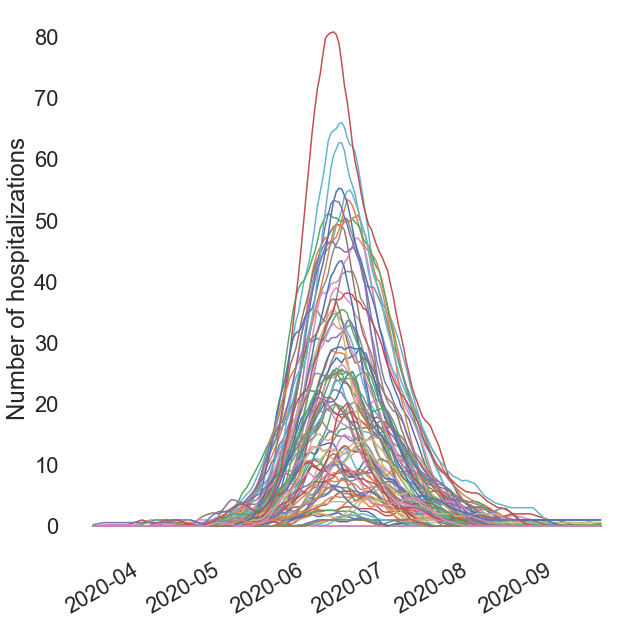

In [406]:
sim_ih = sim_arr.sel({'compartment': 'Ih'}).sum(dim=['risk_group', 'age_group'])
sim_rm = sim_ih.rolling(step=7, center=True).mean()
with sns.plotting_context("notebook", font_scale=2):
    sns.set_style('white')
    fig, ax = plt.subplots(1, 1, figsize=(10,10))
    sim_rm.plot(
        hue='vertex',
        x='step'
    )
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.get_legend().remove()
    ax.set_title('')
    ax.set_xlabel('')
    ax.set_ylabel('Number of hospitalizations')
    plt.savefig('/Users/kpierce/episimlab/demo_atx_ih_timeseries.png')
    plt.show()

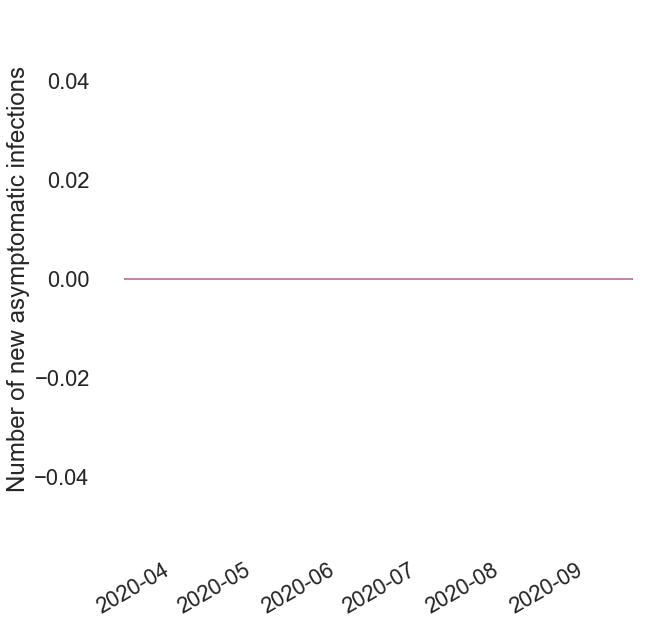

In [409]:
sim_ih = sim_arr.sel({'compartment': 'Pa2Ia'}).sum(dim=['risk_group', 'age_group'])
sim_rm = sim_ih.rolling(step=7, center=True).mean()
with sns.plotting_context("notebook", font_scale=2):
    sns.set_style('white')
    fig, ax = plt.subplots(1, 1, figsize=(10,10))
    sim_rm.plot(
        hue='vertex',
        x='step'
    )
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.get_legend().remove()
    ax.set_title('')
    ax.set_xlabel('')
    ax.set_ylabel('Number of new asymptomatic infections')
    plt.show()

In [410]:
sim_arr * 10

<xarray.DataArray 'apply_counts_delta__counts' (step: 195, vertex: 87, age_group: 5, risk_group: 2, compartment: 16)>
dask.array<mul, shape=(195, 87, 5, 2, 16), dtype=float64, chunksize=(98, 44, 3, 1, 8), chunktype=numpy.ndarray>
Coordinates:
  * age_group    (age_group) object '18-49' '5-17' '50-64' '65+' '<5'
  * compartment  (compartment) object 'S' 'E' 'Pa' ... 'Py2Iy' 'Iy2Ih' 'H2D'
  * risk_group   (risk_group) object 'low' 'high'
  * step         (step) datetime64[ns] 2020-03-11 2020-03-12 ... 2020-09-21
  * vertex       (vertex) float64 7.651e+04 7.653e+04 ... 7.895e+04 7.896e+04

In [411]:
sim_arr

<xarray.DataArray 'apply_counts_delta__counts' (step: 195, vertex: 87, age_group: 5, risk_group: 2, compartment: 16)>
dask.array<xarray-apply_counts_delta__counts, shape=(195, 87, 5, 2, 16), dtype=float64, chunksize=(98, 44, 3, 1, 8), chunktype=numpy.ndarray>
Coordinates:
  * age_group    (age_group) object '18-49' '5-17' '50-64' '65+' '<5'
  * compartment  (compartment) object 'S' 'E' 'Pa' ... 'Py2Iy' 'Iy2Ih' 'H2D'
  * risk_group   (risk_group) object 'low' 'high'
  * step         (step) datetime64[ns] 2020-03-11 2020-03-12 ... 2020-09-21
  * vertex       (vertex) float64 7.651e+04 7.653e+04 ... 7.895e+04 7.896e+04